In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Creating the Environment

In [2]:
!pip install torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-q7cqr8lk
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-q7cqr8lk
     |████████████████████████████████| 276kB 3.6MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.1-cp36-none-any.whl size=46961 sha256=6af36edb44de58339276be755cf555d8acc70446cd61b1c94f40cdf22872b0e8
  Stored in directory: /tmp/pip-ephem-wheel-cache-vf0zcgj0/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel for pyyaml: filename=PyYAML-5.3.1-cp36-cp36m-linux_x86_64.whl size=44621 sha256=f8f4d53698d2970b2b31efecf3c495a17d8d88b6a564ff93496bfb3e5b6d10e5
  Stored in directory: /root/.cache/pip/wheels/a7/c1/ea/cf5bd31012e735dc1dfea3131a2d5eae7978b251083d6247bd
Successfully built fvcore pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


'1.6.0+cu101'

In [3]:
!git clone https://github.com/facebookresearch/detectron2 Objectdetection
!pip install -e Objectdetection

Cloning into 'Objectdetection'...
remote: Enumerating objects: 4, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 6290 (delta 1), reused 4 (delta 1), pack-reused 6286
Receiving objects: 100% (6290/6290), 2.83 MiB | 21.82 MiB/s, done.
Resolving deltas: 100% (4558/4558), done.
Obtaining file:///content/Objectdetection
     |████████████████████████████████| 2.2MB 55kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0
  Running setup.py develop for detectron2


In [1]:
%cd /content/Objectdetection

/content/Objectdetection


In [2]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [3]:
%cd /content/drive/My\ Drive
#!cp model_final.pth /content/Objectdetection/outputs
# !zip -r data.zip data/
!cp -r data.zip   /content/Objectdetection

%cd /content/Objectdetection/
!unzip data.zip

/content/drive/My Drive
/content/Objectdetection
Archive:  data.zip
   creating: data/
   creating: data/.ipynb_checkpoints/
  inflating: data/military_coco_creation.json  
   creating: data/shapes/
  inflating: data/shapes/118.jpg     
  inflating: data/shapes/101.jpg     
  inflating: data/shapes/120.jpg     
  inflating: data/shapes/103.jpg     
  inflating: data/shapes/123.jpg     
  inflating: data/shapes/117.jpg     
  inflating: data/shapes/114.jpg     
  inflating: data/shapes/102.jpg     
  inflating: data/shapes/97.jpg      
  inflating: data/shapes/105.jpg     
  inflating: data/shapes/107.jpg     
  inflating: data/shapes/98.jpg      
  inflating: data/shapes/108.jpg     
  inflating: data/shapes/124.jpg     
  inflating: data/shapes/99.jpg      
  inflating: data/shapes/115.jpg     
  inflating: data/shapes/116.jpg     
  inflating: data/shapes/100.jpg     
  inflating: data/shapes/106.jpg     
  inflating: data/shapes/110.jpg     
  inflating: data/shapes/109.jpg     
  i

In [4]:
!pwd

/content/Objectdetection


In [5]:
%cd /content

/content


In [6]:
!unzip shapestest.zip

Archive:  shapestest.zip
   creating: shapestest/
  inflating: shapestest/25.jpg       
  inflating: shapestest/106.jpg      
  inflating: shapestest/87.jpg       
  inflating: shapestest/172.jpg      
  inflating: shapestest/161.jpg      
  inflating: shapestest/76.jpg       
  inflating: shapestest/129.jpg      
  inflating: shapestest/53.jpg       
  inflating: shapestest/191.jpg      
  inflating: shapestest/31.jpg       
  inflating: shapestest/126.jpg      
  inflating: shapestest/114.jpg      
  inflating: shapestest/17.jpg       
  inflating: shapestest/70.jpg       
  inflating: shapestest/168.jpg      
  inflating: shapestest/195.jpg      
  inflating: shapestest/124.jpg      
  inflating: shapestest/121.jpg      
  inflating: shapestest/93.jpg       
  inflating: shapestest/69.jpg       
  inflating: shapestest/158.jpg      
  inflating: shapestest/122.jpg      
  inflating: shapestest/174.jpg      
  inflating: shapestest/62.jpg       
  inflating: shapestest/89.jpg       


In [7]:
!unzip shapesval.zip

Archive:  shapesval.zip
   creating: shapesval/
  inflating: shapesval/25.jpg        
  inflating: shapesval/106.jpg       
  inflating: shapesval/87.jpg        
  inflating: shapesval/76.jpg        
  inflating: shapesval/53.jpg        
  inflating: shapesval/31.jpg        
  inflating: shapesval/114.jpg       
  inflating: shapesval/17.jpg        
  inflating: shapesval/70.jpg        
  inflating: shapesval/93.jpg        
  inflating: shapesval/69.jpg        
  inflating: shapesval/62.jpg        
  inflating: shapesval/89.jpg        
  inflating: shapesval/56.jpg        
  inflating: shapesval/77.jpg        
  inflating: shapesval/95.jpg        
  inflating: shapesval/24.jpg        
  inflating: shapesval/119.jpg       
  inflating: shapesval/7.jpg         
  inflating: shapesval/105.jpg       
  inflating: shapesval/67.jpg        
  inflating: shapesval/111.jpg       
  inflating: shapesval/51.jpg        
  inflating: shapesval/71.jpg        
  inflating: shapesval/92.jpg        
  

In [8]:
%cd /content/Objectdetection

/content/Objectdetection


In [9]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("military_image_train", {}, "data/military_coco_creation_train.json", "data/shapes")
register_coco_instances("military_image_val", {}, "data/military_coco_creation_val.json", "data/shapesval")
register_coco_instances("military_image_test", {}, "data/military_coco_creation_test.json", "data/shapestest")

In [10]:
from detectron2.data import DatasetCatalog, MetadataCatalog
military_image_metadata = MetadataCatalog.get("military_image_train")
dataset_dicts = DatasetCatalog.get("military_image_train")

[08/09 10:12:10 d2.data.datasets.coco]: Loaded 1100 images in COCO format from data/military_coco_creation_train.json


In [11]:
from detectron2.data import DatasetCatalog, MetadataCatalog
military_image_metadata_test = MetadataCatalog.get("military_image_test")
dataset_dicts_test = DatasetCatalog.get("military_image_test")

[08/09 10:12:17 d2.data.datasets.coco]: Loaded 200 images in COCO format from data/military_coco_creation_test.json


In [21]:
from detectron2.data import DatasetCatalog, MetadataCatalog
military_image_metadata_val = MetadataCatalog.get("military_image_val")
dataset_dicts_test = DatasetCatalog.get("military_image_val")

[08/09 12:44:52 d2.data.datasets.coco]: Loaded 120 images in COCO format from data/military_coco_creation_val.json


## Visualization of grund truth images with classes

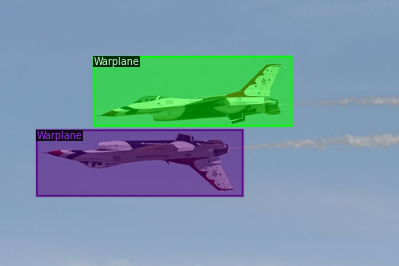

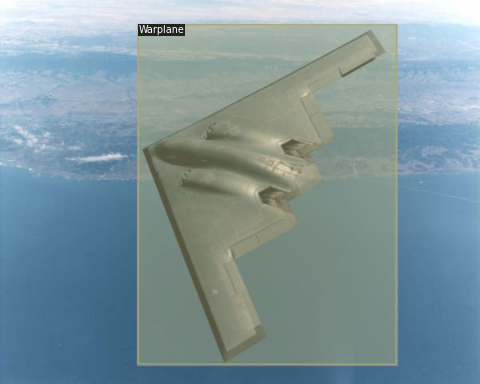

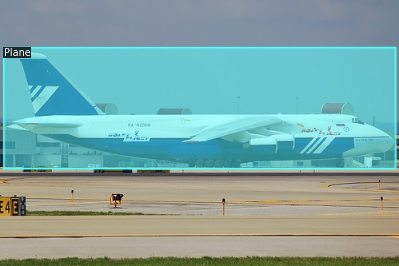

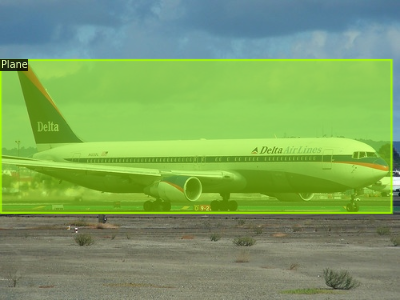

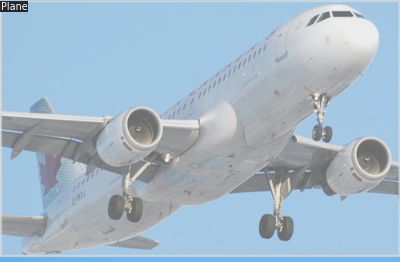

...

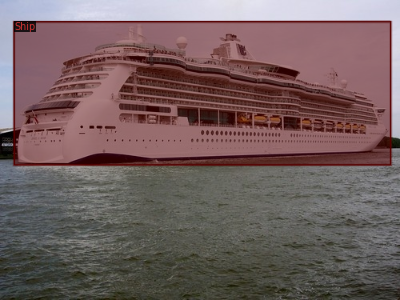

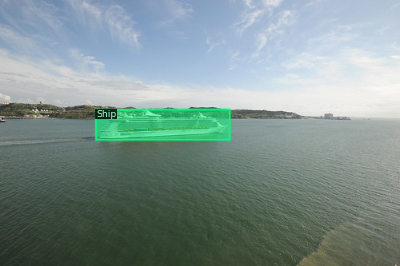

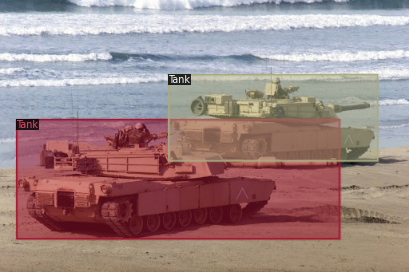

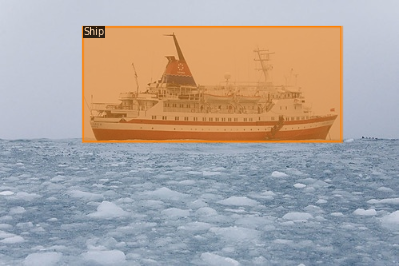

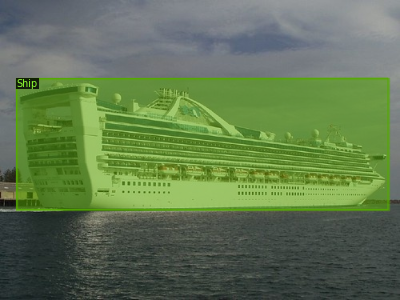

In [13]:
import random


for d in random.sample(dataset_dicts, 15):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=military_image_metadata, scale=0.8)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [14]:
!pwd 

/content/Objectdetection


## Calling The Confi File 

In [15]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file("configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("military_image_train",)
cfg.DATASETS.TEST = ("military_image_train",)
#cfg.DATASETS.TEST = ("military_image_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl"  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.01

#cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 20000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8 
cfg.TEST.EVAL_PERIOD = 10000




In [16]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

## Training The Model

In [17]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)

trainer.train()

[08/09 10:22:30 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:11, 21.0MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (9, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (32, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (32,) in the model! You might want to double check if this is expected.


[08/09 10:22:47 d2.engine.train_loop]: Starting training from iteration 0


/content/Objectdetection/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  return x.nonzero().unbind(1)


[08/09 10:22:55 d2.utils.events]:  eta: 2:04:29  iter: 19  total_loss: 2.358  loss_cls: 1.834  loss_box_reg: 0.531  loss_rpn_cls: 0.007  loss_rpn_loc: 0.012  time: 0.3865  data_time: 0.0144  lr: 0.000200  max_mem: 3666M
[08/09 10:23:03 d2.utils.events]:  eta: 2:04:19  iter: 39  total_loss: 1.351  loss_cls: 0.658  loss_box_reg: 0.665  loss_rpn_cls: 0.006  loss_rpn_loc: 0.009  time: 0.3810  data_time: 0.0043  lr: 0.000400  max_mem: 3666M
[08/09 10:23:11 d2.utils.events]:  eta: 2:08:14  iter: 59  total_loss: 0.903  loss_cls: 0.386  loss_box_reg: 0.515  loss_rpn_cls: 0.003  loss_rpn_loc: 0.010  time: 0.3885  data_time: 0.0056  lr: 0.000599  max_mem: 3788M
[08/09 10:23:19 d2.utils.events]:  eta: 2:06:16  iter: 79  total_loss: 0.943  loss_cls: 0.367  loss_box_reg: 0.581  loss_rpn_cls: 0.001  loss_rpn_loc: 0.007  time: 0.3862  data_time: 0.0051  lr: 0.000799  max_mem: 3788M
[08/09 10:23:26 d2.utils.events]:  eta: 2:07:11  iter: 99  total_loss: 0.804  loss_cls: 0.281  loss_box_reg: 0.561  loss

## Visualizing Trained Model

In [18]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [23]:
import os
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file("configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = os.path.join('output/', "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.9  # set the testing threshold for this model
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8
cfg.DATASETS.TEST = ("military_image_train", )
predictor = DefaultPredictor(cfg)

In [24]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("military_image_train", cfg, False, output_dir="output/")
val_loader = build_detection_test_loader(cfg, "military_image_train")
inference_on_dataset(predictor.model, val_loader, evaluator)

[08/09 12:48:09 d2.data.datasets.coco]: Loaded 1100 images in COCO format from data/military_coco_creation_train.json
[08/09 12:48:09 d2.data.common]: Serializing 1100 elements to byte tensors and concatenating them all ...
[08/09 12:48:09 d2.data.common]: Serialized dataset takes 0.47 MiB
[08/09 12:48:09 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/09 12:48:09 d2.evaluation.evaluator]: Start inference on 1100 images
[08/09 12:48:11 d2.evaluation.evaluator]: Inference done 11/1100. 0.0961 s / img. ETA=0:01:46
[08/09 12:48:16 d2.evaluation.evaluator]: Inference done 64/1100. 0.0937 s / img. ETA=0:01:38
[08/09 12:48:21 d2.evaluation.evaluator]: Inference done 117/1100. 0.0936 s / img. ETA=0:01:33
[08/09 12:48:26 d2.evaluation.evaluator]: Inference done 170/1100. 0.0935 s / img. ETA=0:01:28
[08/09 12:48:31 d2.evaluation.evaluator]: Inference done 223/1100. 0.0934 s / img. ETA=0:01:23
[

OrderedDict([('bbox',
              {'AP': 81.16719981092805,
               'AP-MilitaryJeep': 77.1489077414871,
               'AP-MilitaryTruck': 81.95523687836524,
               'AP-Person': 72.4025009031431,
               'AP-Plane': 85.13864637545457,
               'AP-Ship': 85.67887876928589,
               'AP-Tank': 85.90252495750846,
               'AP-Warplane': 74.87140286225728,
               'AP-Warship': 86.23949999992284,
               'AP50': 98.6336765140658,
               'AP75': 97.37328735879048,
               'APl': 83.93163816075264,
               'APm': 72.01161662789497,
               'APs': 76.76419132596489})])

## Visualizing the Model Predictions on Training Data

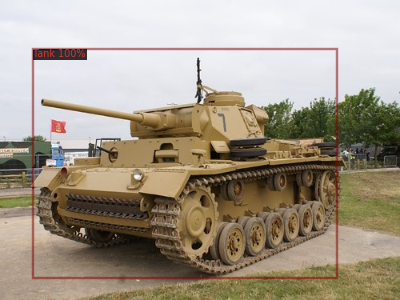

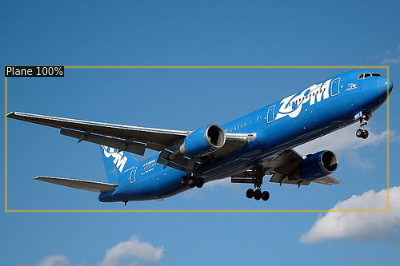

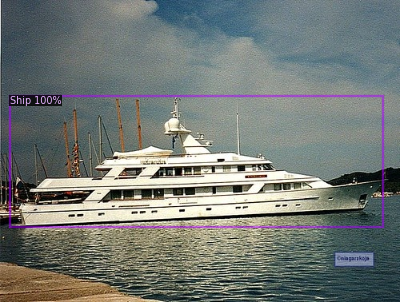

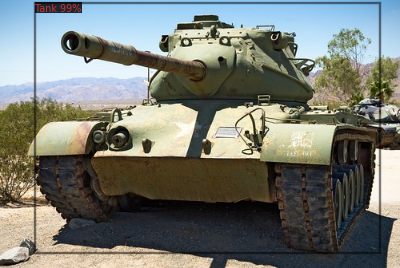

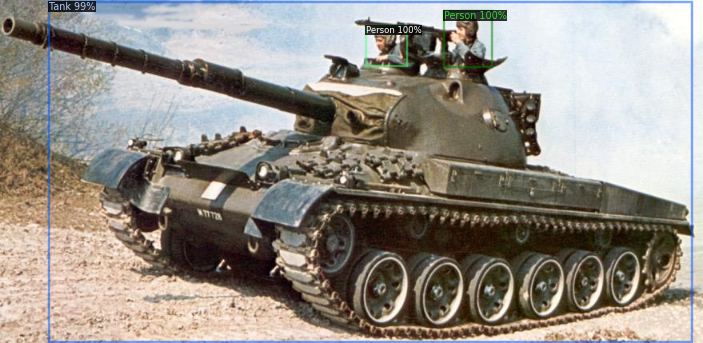

...

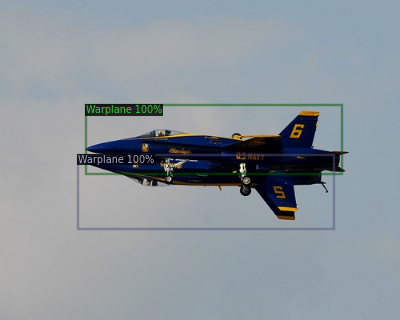

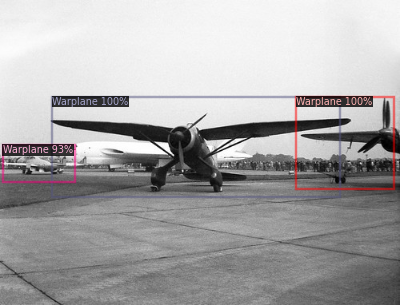

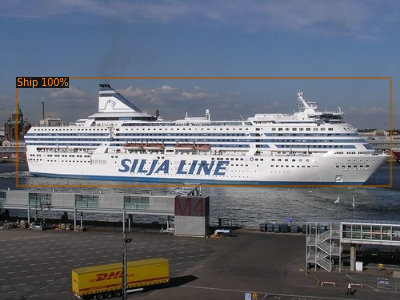

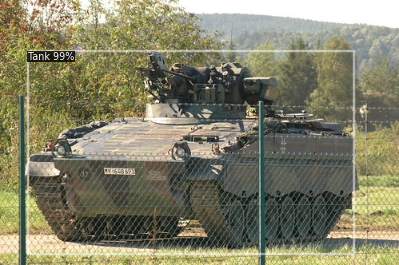

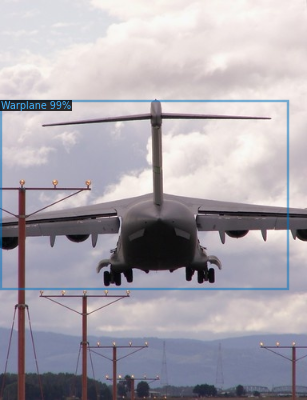

In [25]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_military_dicts("military_image_train")
for d in random.sample(dataset_dicts, 15):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=military_image_metadata, 
                   scale=0.8, 
                  #  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

## Tesing the Model on Test Data 

In [32]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("military_image_test", cfg, False, output_dir="output/")
val_loader = build_detection_test_loader(cfg, "military_image_test")
inference_on_dataset(predictor.model, val_loader, evaluator)

[08/09 13:06:07 d2.data.datasets.coco]: Loaded 200 images in COCO format from data/military_coco_creation_test.json
[08/09 13:06:07 d2.data.common]: Serializing 200 elements to byte tensors and concatenating them all ...
[08/09 13:06:07 d2.data.common]: Serialized dataset takes 0.10 MiB
[08/09 13:06:07 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/09 13:06:07 d2.evaluation.evaluator]: Start inference on 200 images
[08/09 13:06:09 d2.evaluation.evaluator]: Inference done 11/200. 0.0911 s / img. ETA=0:00:17
[08/09 13:06:14 d2.evaluation.evaluator]: Inference done 66/200. 0.0906 s / img. ETA=0:00:12
[08/09 13:06:24 d2.evaluation.evaluator]: Inference done 175/200. 0.0912 s / img. ETA=0:00:02
[08/09 13:06:26 d2.evaluation.evaluator]: Total inference time: 0:00:18.181399 (0.093238 s / img per device, on 1 devices)
[08/09 13:06:26 d2.evaluation.evaluator]: Total inference pure compute time

OrderedDict([('bbox',
              {'AP': 67.17973710008916,
               'AP-MilitaryJeep': 77.53269502774452,
               'AP-MilitaryTruck': 63.71654320533114,
               'AP-Person': 27.202532377188255,
               'AP-Plane': 87.45976389819815,
               'AP-Ship': 78.31316771458125,
               'AP-Tank': 63.36257869327845,
               'AP-Warplane': 62.29371891649919,
               'AP-Warship': 77.55689696789227,
               'AP50': 85.92754838894638,
               'AP75': 79.36665789040975,
               'APl': 73.09549950145707,
               'APm': 35.613391990138794,
               'APs': 17.722772277227723})])

## Visualizing the Test Output Predictions

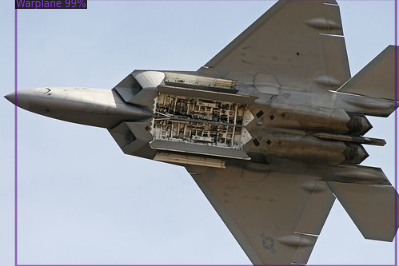

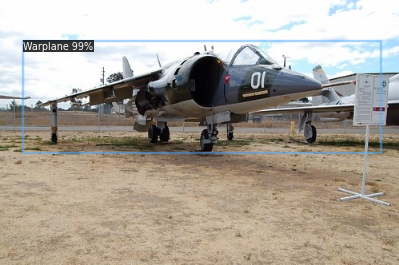

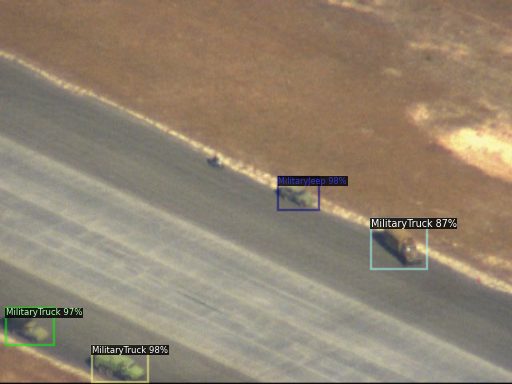

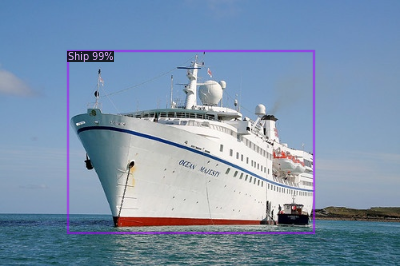

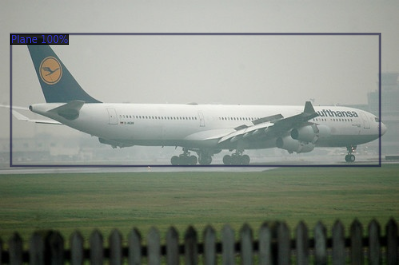

...

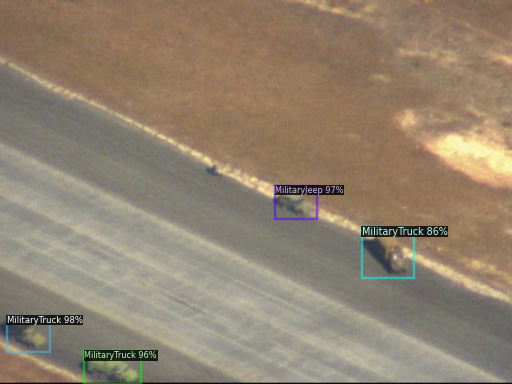

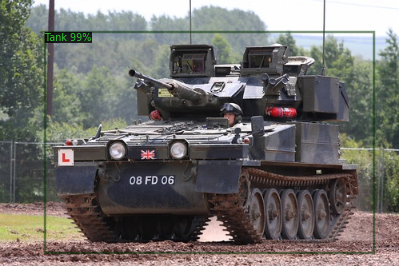

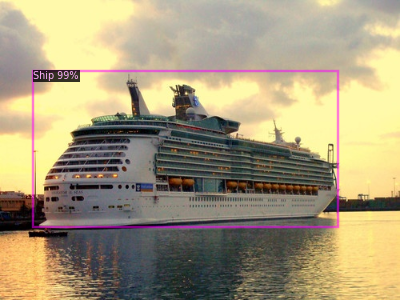

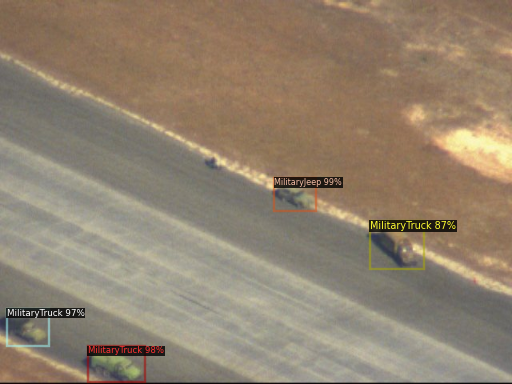

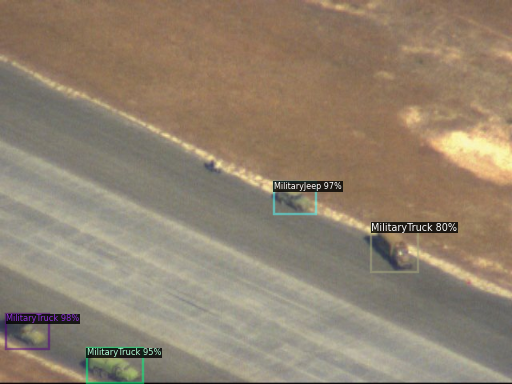

In [33]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_military_dicts("military_image_train")
for d in random.sample(dataset_dicts_test, 15):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=military_image_metadata_test, 
                   scale=0.8, 
                  #  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

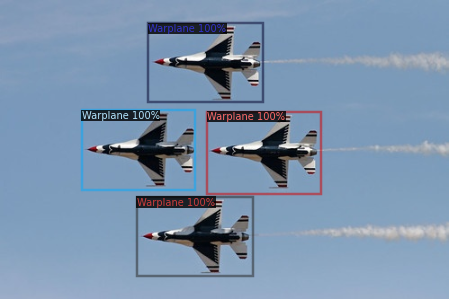

In [42]:
from detectron2.utils.visualizer import ColorMode  

im = cv2.imread('/content/Objectdetection/data/shapes/896.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                  metadata=military_image_metadata, 
                  scale=0.90, 
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

## Random Image Taken From Google 

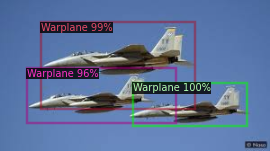

In [46]:
from detectron2.utils.visualizer import ColorMode  

im = cv2.imread('/content/images1.jfif')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                  metadata=military_image_metadata,
                  scale=0.90, 
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

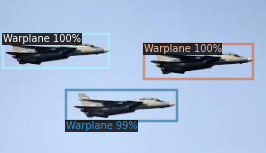

In [45]:
from detectron2.utils.visualizer import ColorMode  

im = cv2.imread('/content/images.jfif')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                  metadata=military_image_metadata, 
                  scale=0.90, 
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])